In [67]:
# My first Jupyter Notebook
%pip install numpy
%pip install scikit-image

Note: you may need to restart the kernel to use updated packages.



In [10]:
!pip install Pillow
!pip install scikit-image
!pip install matplotlib
!pip install scipy
!pip install skimage
!pip install numpy
!pip install timeit

  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'error'


  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> [3 lines of output]
      
      *** Please install the `scikit-image` package (instead of `skimage`) ***
      
      [end of output]
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.


ERROR: Could not find a version that satisfies the requirement timeit (from versions: none)
ERROR: No matching distribution found for timeit


# IMAGE FORMATION - SAMPLING AND QUANTIZATION
- Trong phần này ta sẽ bàn về 2 vấn đề với việc hình thành hình ảnh (image formation) bao gồm sampling và quantization, và xem cách chúng ta resize ảnh với sampling và các màu sắc được lượng tử hóa với thư viện PIL và scikit-image

In [2]:
# Cai dat thu vien
from PIL import Image
from skimage.io import imread, imshow, show
import scipy.fftpack as fp
from scipy import ndimage, misc, signal
# from scipy.stats import signaltonoise
from skimage import data, img_as_float
from skimage.color import rgb2gray
from skimage.transform import rescale
import matplotlib.pylab as pylab
import numpy as np
import numpy.fft
import timeit

## SAMPLING (Lấy mẫu)
- Sampling đề cập tới sự chọn lựa/sự từ bỏ các pixel ảnh, nghĩa là đó là một
spatial operation
- Ta dùng lấy mẫu để tăng hoặc giảm kích thước ảnh, với up-sampling và down-sampling

### UP-SAMPLING
Một bức ảnh lớn hơn sẽ có vài pixel không có pixel tương ứng trong ảnh gốc, và ta cần đoán các giá trị pixel chưa biết đó. Ta có thể đoán giá trị của một pixel chưa biết sử dụng các cách:
+ Một tổng hợp (aggregate), ví dụ, giá trị trung bình của một hoặc nhiều giá trị pixel-neighbors gần nhất đã biết của nó
+ Một giá trị nội suy (interpolated value) bằng cách sử dụng pixel-neighbors với nội suy song tuyến tính hoặc khối

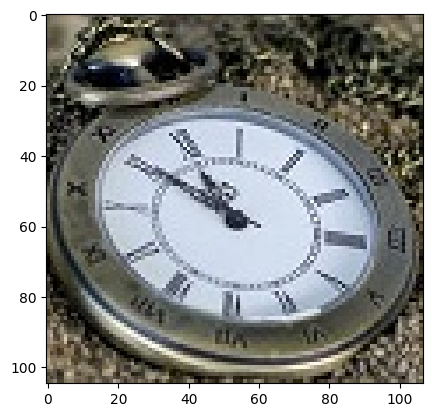

(<matplotlib.image.AxesImage at 0x19e07212210>, None)

In [3]:
'''Nearest neighbour-based up-sampling có thể cho ảnh đầu ra kém chất lượng'''
# Mo anh va show anh tu duong dan
im = Image.open('../../image/clock.jpg')
pylab.imshow(im), pylab.show()

Đoạn code dưới phóng to ảnh lên 25 lần bằng cách sử dụng phép nội suy láng giềng gần nhất (nearest neighbor interpolation), sau đó hiển thị ảnh đã được phóng to
- Image.NEAREST chỉ định phương pháp nội suy láng giềng gần nhất. Trong phương pháp này, mỗi pixel mới lấy giá trị của pixel gần nhất từ ảnh gốc, tạo ra hiệu ứng "khối" hoặc "pixel hóa" (các pixel lớn hơn rõ ràng) khi phóng to ảnh

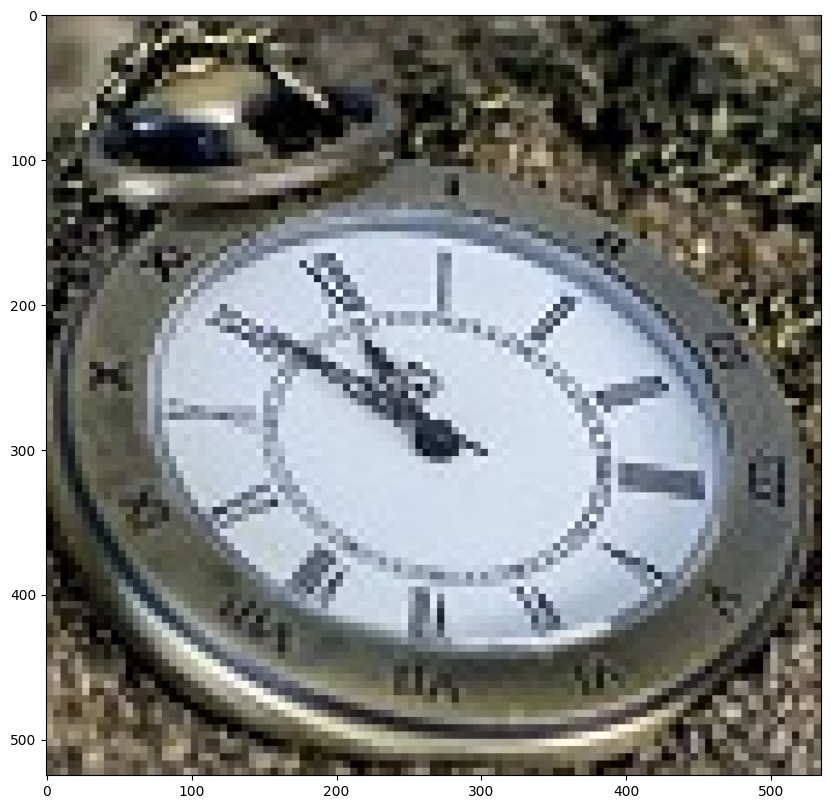

'\n- Có thể thấy ảnh đầu ra rất kém chất lượng\n'

In [ ]:
# Phong to anh len 25 lan
im1 = im.resize((im.width*5, im.height*5), Image.NEAREST) # nearest neighbor interpolation
pylab.figure(figsize=(10,10)), pylab.imshow(im1), pylab.show()
'''
- Có thể thấy ảnh đầu ra rất kém chất lượng
'''

## UP-SAMPLING VÀ PHÉP NỘI SUY (INTERPOLATION)
Để cải thiện chất lượng ảnh, ta sử dụng phương pháp nội suy song tuyến tính hoặc nội suy bi-cubic

### NỘI SUY SONG TUYẾN TÍNH
- Xét một bức ảnh xám, bản chất là ma trận 2 chiều với các giá trị pixel ở vị trí tọa độ số nguyên. Để lượng tử hóa giá trị pixel ở điểm P bất kỳ trên ko gian, có thể sử dụng nội quy song tuyến tính
- Đối với mỗi điểm P, 4 hàng xóm ($Q_{11}$, $Q_{12}$, $Q_{21}$, $Q_{22}$) sẽ ở đó và giá trị mức xám (intensity values) của 4 hàng xóm sẽ được kết hợp để tính interpolated intensity ở điểm P như ở hình vẽ sau:
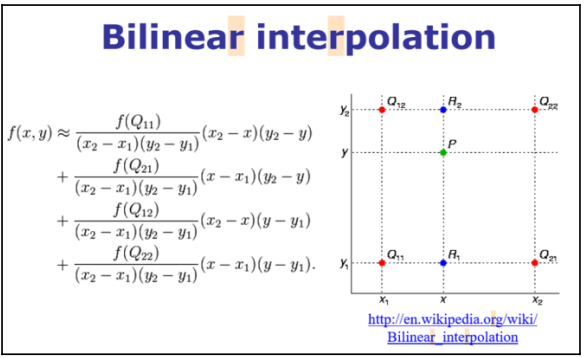

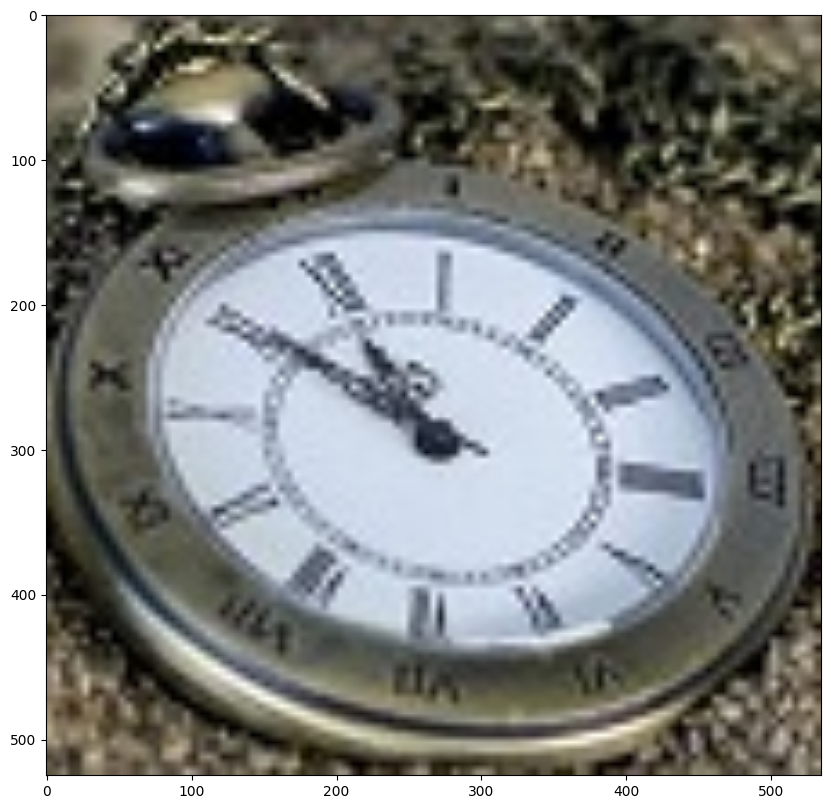

(<Figure size 1000x1000 with 1 Axes>,
 None)

In [ ]:
# Thuật toán Bi-linear interpolation
# Sử dụng hàm resize() từ PIL để làm bi - linear interpolation
im1 = im.resize((im.width*5, im.height*5), Image.BILINEAR) # up-sample with bi-linear interpolation
pylab.figure(figsize=(10,10)), pylab.imshow(im1), pylab.show()

### BI-CUBIC INTERPOLATION
- Nó là bản mở rộng của cubic interpolation cho việc lượng tử hóa các điểm dữ liệu trong không gian 2 chiều. Mặt phẳng được lượng tử hóa sẽ mượt hơn so với mặt phẳng sử dụng lượng tử song tuyến tính hay lượng tử nearest-neighbour
- Bi-cubic interpolation có thể đạt được bằng việc sử dụng đa thức Lagrange, cubic splines, hay tích chập bậc ba (cubic convolution). PIL sử dụng spline interpolation trong không gian 4x4

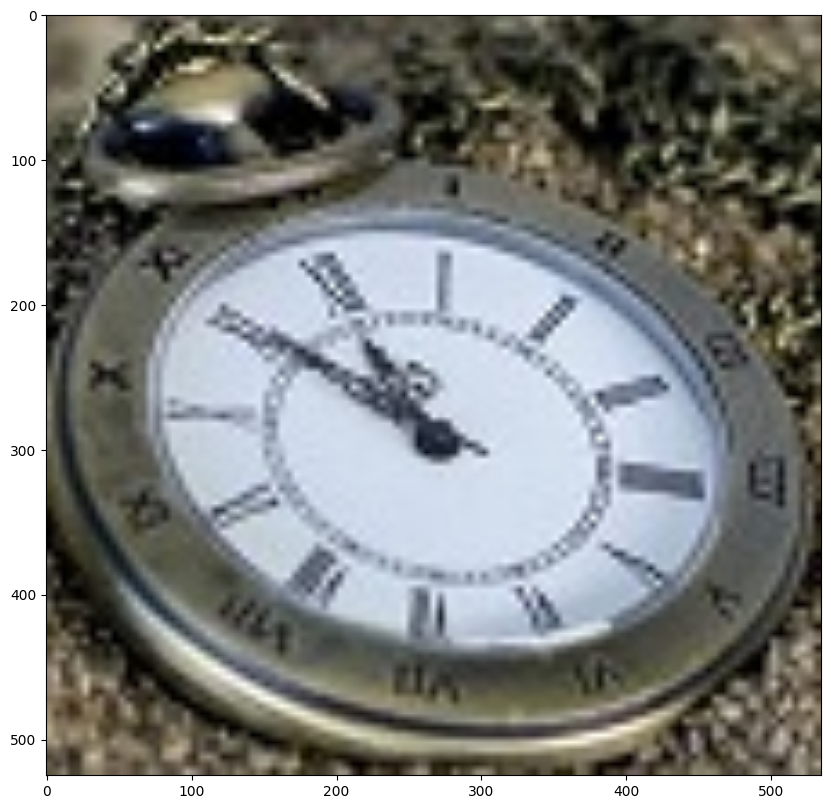

(<Figure size 1000x1000 with 1 Axes>,
 None)

In [ ]:
# Bi-cubic interpolation
im.resize((im.width*10, im.height*10), Image.BICUBIC).show() # bi-cubic interpolation
pylab.figure(figsize=(10,10)), pylab.imshow(im1), pylab.show()
# Có thể thấy chất lượng ảnh được cải thiện khi dùng bicubic interpolation

### DOWN-SAMPLING
Để giảm kích cỡ ảnh, ta cần down-sample ảnh. Mỗi pixel trong ảnh được down-sample sẽ có nhiều pixel trong ảnh gốc. Ta có thể tính giá trị của một pixel trong ảnh mới bằng cách:
- Bỏ vài pixel (VD: bỏ mỗi dòng và cột nếu ta muốn ảnh thu nhỏ nhỏ hơn 4 lần ảnh gốc) từ ảnh lớn hơn
- Tính giá trị pixel mới như là giá trị kết hợp (aggregate value) của các pixel tương ứng trong ảnh gốc

In [9]:
# Show ảnh Tajmahal
# Sử dụng ảnh này với mục đích cho ảnh kết quả đầu ra nhỏ hơn ảnh gốc 25 lần

im = Image.open('../../image/tajmahal.jpg')
im.show()

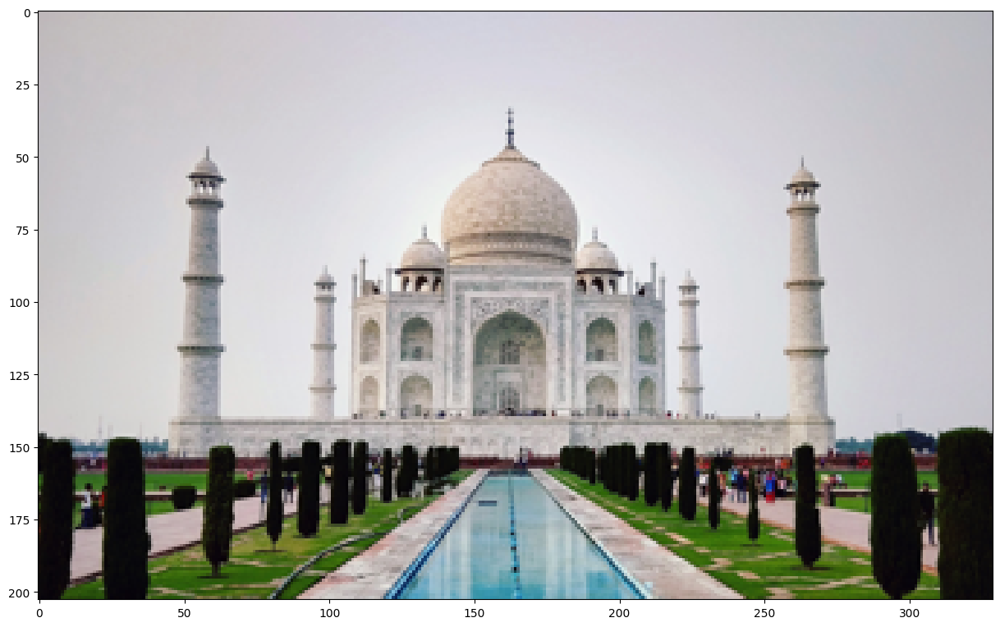

'\nCó thể thấy ảnh có vào vệt đen/artifacts và các pattern mà ban đầu không có trong\nảnh gốc. Hiệu ứng này được gọi là aliasing\n- Aliasing xảy ra khi sampling rate thấp hơn Nyquist rate (Có quá ít pixels)\n'

In [10]:
# Giảm chiều dài và chiều rộng đi 5 lần

im = im.resize((im.width//5, im.height//5))
pylab.figure(figsize=(15,10)), pylab.imshow(im), pylab.show()
'''
Có thể thấy ảnh có vào vệt đen/artifacts và các pattern mà ban đầu không có trong
ảnh gốc. Hiệu ứng này được gọi là aliasing
- Aliasing xảy ra khi sampling rate thấp hơn Nyquist rate (Có quá ít pixels)
'''

### DOWN SAMPLING VÀ ANTI-ALIASING
#### Anti-aliasing
Vấn đề là một pixel trong ảnh đầu ra ứng với 25 pixel ở ảnh gốc, nhưng ta đang lấy mẫu giá trị của một pixel. Ta nên tính trung bình trên một khu vực nhỏ ở ảnh gốc. Làm việc này bằng cách dùng ANTIALIAS

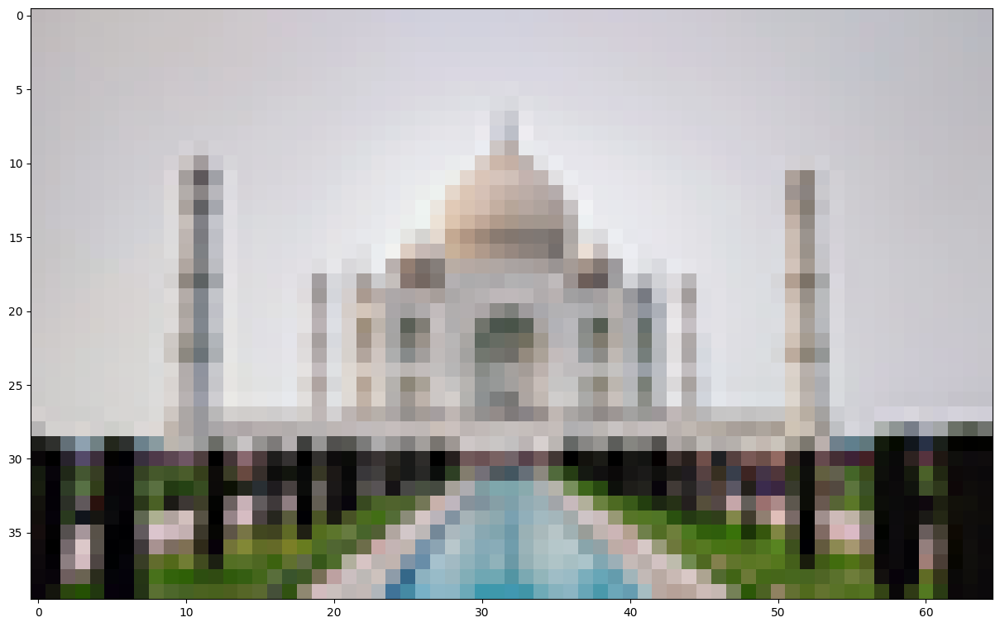

(<Figure size 1500x1000 with 1 Axes>,
 None)

In [11]:
# Sử dụng kỹ thuật Anti Alias
# Antialias không còn nằm trong thư viện Image nên ta thay bằng LANCZOS
im = im.resize((im.width//5, im.height//5), Image.LANCZOS) 
pylab.figure(figsize=(15,10)), pylab.imshow(im), pylab.show()

Anti-alias được thực hiện bằng việc làm mượt ảnh (thông qua phép tích chập hình ảnh với bộ lọc thông thấp như bộ lọc Gaussian) trước khi down-sampling

Giờ sử dụng hàm rescale() với anti-aliasing để vượt qua vấn đề aliasing với ảnh umbc.png:

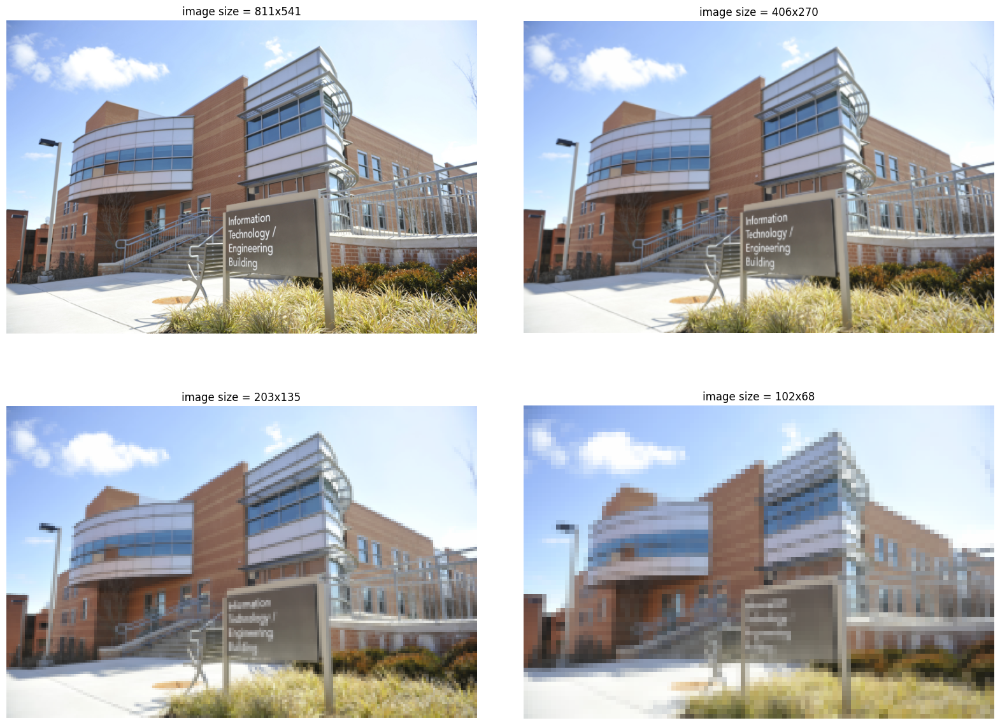

'\nCó thể thấy ảnh được down-sample để tạo ra ảnh đầu ra nhỏ hơn - Hiệu ứng aliasing\nngày càng rõ ràng khi không có kỹ thuật anti-aliasing được sử dụng\n\nThay dòng code sử dụng anti-aliasing (đổi anti_aliasing=True) ảnh sẽ có chất lượng\ntốt hơn\n'

In [ ]:
# Tham số multichannel được thay thế bằng channel_axis trong các phiên bản mới của scikit-image
# Thay multichannel=True thành channel_axis = -1 để chỉ định rằng kênh màu nằm ở trục cuối cùng
'''
GIẢI THÍCH ĐOẠN CODE DƯỚI:
- pylab.figure(figsize=(20,15)): Tạo một cửa sổ vẽ lớn có kích thước 20x15 inch, để 
dễ dàng hiển thị nhiều ảnh trong cùng một không gian
- Trong vòng for lặp qua bốn lần để tạo bốn phiên bản ảnh với kích thước giảm dần:
+ pylab.subplot(2,2,i+1): Tạo một subplot trong bố cục 2x2, vị trí là i+1
+ pylab.imshow(im1, cmap='gray'): Hiển thị ảnh im1 trong màu xám (cmap='gray')
+ pylab.axis('off'): Tắt trục tọa độ để ảnh được hiển thị rõ hơn
+ pylab.title(...): Gắn tiêu đề cho từng ảnh, hiển thị kích thước hiện tại của ảnh
+ rescale(im1, scale=0.5, channel_axis=-1, anti_aliasing=True): Giảm kích thước 
ảnh xuống 50% với nội suy kênh màu
- pylab.subplots_adjust(wspace=0.1, hspace=0.1): Điều chỉnh khoảng cách giữa các 
ảnh trong lưới 2x2
- pylab.show(): Hiển thị cửa sổ vẽ với các ảnh giảm kích thước.
'''
im = imread('../../image/umbc.png')
im1 = im.copy()
pylab.figure(figsize=(20,15))
for i in range(4):
  pylab.subplot(2,2,i+1), pylab.imshow(im1, cmap='gray'), pylab.axis('off')
  pylab.title('image size = ' + str(im1.shape[1]) + 'x' + str(im1.shape[0]))
  # im1 = rescale(im1, scale = 0.5, channel_axis=-1, anti_aliasing=False)
  im1 = rescale(im1, scale = 0.5, channel_axis=-1, anti_aliasing=True)
pylab.subplots_adjust(wspace=0.1, hspace=0.1)
pylab.show()

'''
Có thể thấy ảnh được down-sample để tạo ra ảnh đầu ra nhỏ hơn - Hiệu ứng aliasing
ngày càng rõ ràng khi không có kỹ thuật anti-aliasing được sử dụng

Thay dòng code sử dụng anti-aliasing (đổi anti_aliasing=True) ảnh sẽ có chất lượng
tốt hơn
'''

#### QUANTIZATION
- Quantization liên quan đến cường độ của bức ảnh và có thể được xác định bằng số lượng các bits mà mỗi pixel sử dụng. Các bức ảnh kỹ thuật số được lượng tử hóa tới 256 mức xám. Tại đây, ta sẽ thấy khi số bit lưu trữ pixel giảm, lỗi lượng tử hóa tăng lên, dẫn đến các ranh giới nhân tạo hoặc đường viền và hiện tượng pixel hóa, dẫn đến chất lượng hình ảnh kém.

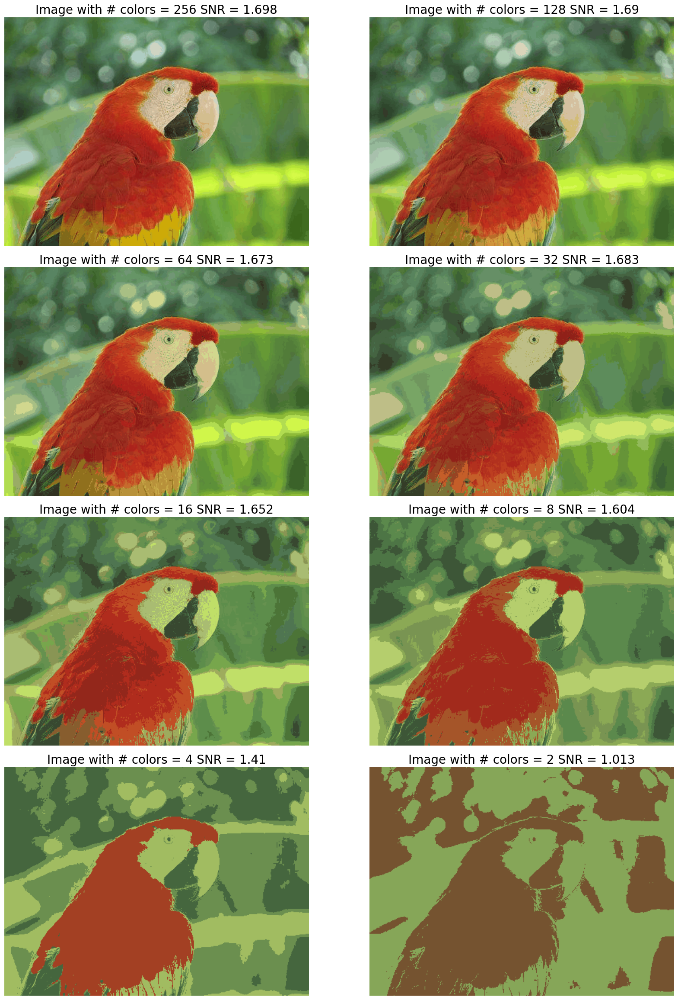

'\nCó thể thấy chất lượng ảnh giảm đi khi số lượng bits lưu trữ pixel giảm\n'

In [ ]:
'''
- Hãy sử dụng module convert() của PIL Image để lượng tử hóa màu sắc với chế độ P và 
tham số color là số lượng màu tối đa.
- Dùng thêm module signaltonoise() của SciPy stats để tìm Signal-to-Noise Ratio (SNR)
của một bức ảnh
LƯU Ý: signaltonoise() là hàm phải viết thêm
'''
#----------------------------------------------------------------
'''
GIẢI THÍCH ĐOẠN CODE:
Đoạn code này thực hiện việc chuyển đổi và hiển thị một hình ảnh thành các phiên 
bản có số lượng màu giảm dần, sau đó tính tỷ lệ tín hiệu trên nhiễu (SNR) cho mỗi 
phiên bản ảnh và hiển thị các giá trị SNR này.
- Hàm signaltonoise():  Hàm này tính tỷ lệ tín hiệu trên nhiễu (SNR) cho một mảng 
a theo trục axis
- pylab.figure(figsize=(20,30)): Tạo cửa sổ lớn để hiển thị các phiên bản ảnh
- num_colors_list = [1 << n for n in range(8,0,-1)]: Tạo danh sách các số màu cho 
các phiên bản ảnh, từ 256 (2^8) màu đến 2 (2^1) màu, theo dạng [256, 128, 64, ..., 2]
- snr_list = []: Khởi tạo danh sách rỗng để lưu các giá trị SNR của các ảnh
- i = 1: Biến đếm để xác định vị trí hiển thị của ảnh trong lưới
- Đối với vòng lặp:
+ im1 = im.convert('P', palette=Image.ADAPTIVE, colors=num_colors): Chuyển đổi 
ảnh im thành ảnh có số lượng màu num_colors với palette ADAPTIVE, giúp giữ lại 
màu sắc chính trong ảnh khi số màu bị giảm
+ pylab.subplot(4,2,i): Tạo một subplot trong lưới 4x2 tại vị trí i
+ pylab.imshow(im1), pylab.axis('off'): Hiển thị ảnh im1 mà không có trục tọa độ
+ snr_list.append(signaltonoise(im1, axis=None)): Tính SNR của ảnh im1 và thêm 
vào danh sách snr_list
+ i += 1: Tăng biến đếm để chuyển sang vị trí tiếp theo.
'''
#--------------------------------------------------------------------------

# Có thể thấy chất lượng ảnh giảm đi khi số lượng bits lưu trữ pixel giảm

def signaltonoise(a, axis=0, ddof=0):
  mean = np.mean(a, axis=axis)
  std_dev = np.std(a, axis=axis, ddof=ddof)
  return np.where(std_dev == 0, 0, mean / std_dev)

im = Image.open('../../image/parrot.jpg')
pylab.figure(figsize=(20,30))
num_colors_list = [1 << n for n in range(8,0,-1)]
snr_list = []
i = 1
for num_colors in num_colors_list:
  im1 = im.convert('P', palette=Image.ADAPTIVE, colors=num_colors)
  pylab.subplot(4,2,i), pylab.imshow(im1), pylab.axis('off')
  snr_list.append(signaltonoise(im1, axis=None))
  pylab.title('Image with # colors = ' + str(num_colors) + ' SNR = ' +
  str(np.round(snr_list[i-1],3)), size=20)
  i += 1
pylab.subplots_adjust(wspace=0.2, hspace=0)
pylab.show()

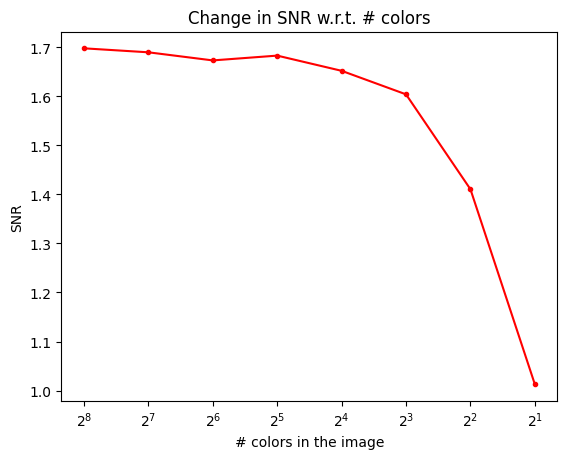

In [14]:
# Giờ ta sẽ vẽ sơ đồ ảnh hưởng của lượng tử hóa mày sắc trên SNR của bức ảnh,
# đó là một độ đo cho chất lượng ảnh - SNR càng cao, chất lượng càng tốt

pylab.plot(num_colors_list, snr_list, 'r.-')
pylab.xlabel('# colors in the image')
pylab.ylabel('SNR')
pylab.title('Change in SNR w.r.t. # colors')
pylab.xscale('log', base=2) #basex trong pylab.xscale() đã bị thay bằng base
pylab.gca().invert_xaxis()
pylab.show()

# Có thể thấy sự lượng tử hóa màu sắc (color-quantization) giảm kích cỡ ảnh, nó 
# cũng khiến cho chất lượng ảnh tệ đi, được đo bằng SNR

# Discrete Fourier Transform
- Chỉ tập trung vào 2D Discrete Fourier Transform (DFT). Ý tưởng đằng sau biến đổi Fourier là ảnh có thể được coi là hàm 2 chiều f mà có thể được thể hiện là tổng các hàm sin và cosin (Các hàm cơ bản của Fourier)

- Chúng ta có thể dịch chuyển từ một set các giá trị mức xám pixel của bức ảnh (spatial/time domain) sang các set hệ số Fourier (frequency domain) sử dụng DFT, và nó là rời rạc bởi các biến spatial và transform (spatial and the transform variables) chỉ có thể lấy một set các giá trị nguyên rời rạc liên tiếp nhau (hay là các vị trí của mảng 2 chiều đại diện bức ảnh)
- Theo cách tương tự, frequency domain mảng 2D các hệ số Fourier có thể được đổi lại thành spatial domain sử dụng IDFT.
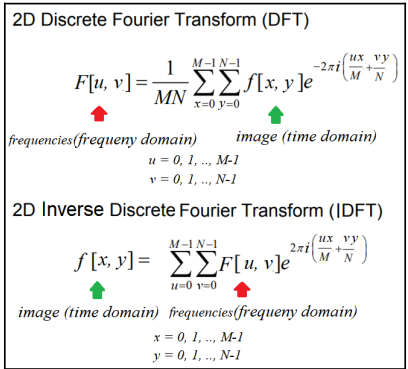

## VÌ SAO CẦN DFT?
- Việc biến đổi sang miền tần số (frequency domain) cho hiểu biết rõ hơn về ảnh
- Tần số thấp trong miền tần số tương ứng với mức thông tin thô trung bình trong một hình ảnh, trong khi tần số cao hơn tương ứng với các cạnh, nhiễu và thông tin chi tiết hơn của một hình ảnh.

### Thuật toán Fast Fourier Transform để tính DFT
- Là thuật toán chia và trị để tính DFT nhanh hơn là tính toán ngây thơ cho bức ảnh n x n với độ phức tạp O(n^2)
#### FFT với module scipy.fftpack
Chúng ta sử dụng hàm fft2()/ifft2() trong scipy.fftpack để tính DFT/IDFT với
thuật toán FFT sử dụng một bức ảnh 

SNR for the original image = 2.0323399414159278
SNR for the image obtained after reconstruction = 2.0323399414159287


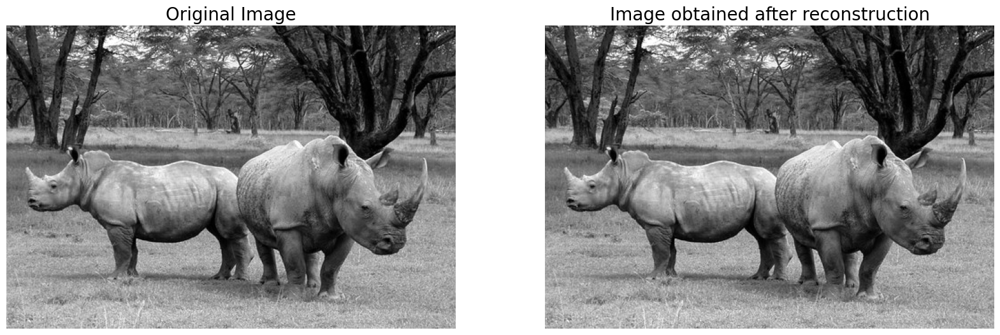

In [ ]:
#---------------------------------------------------------------------------
'''
GIẢI THÍCH ĐOẠN CODE DƯỚI:
- Mở ảnh rhino.jpg, chuyển sang ảnh mức xám (grayscale), rồi chuyển thành mảng 
numpy. Lúc này, im là một mảng 2D đại diện cho cường độ ánh sáng của từng điểm ảnh.
- freq = fp.fft2(im): Thực hiện phép biến đổi Fourier nhanh 2D (FFT) trên ảnh im, 
chuyển từ miền không gian (spatial domain) sang miền tần số (frequency domain). 
Kết quả freq là một mảng phức (complex array) với biên độ và pha của từng tần số 
trong ảnh.
- im1 = fp.ifft2(freq).real: Thực hiện phép biến đổi Fourier ngược (IFFT) trên 
freq để tái tạo lại ảnh gốc. .real lấy phần thực của kết quả, vì kết quả của 
IFFT là số phức.
- snr = signaltonoise(im1, axis=None): Tính SNR của ảnh tái tạo im1
- assert(np.allclose(im, im1)): So sánh im và im1 để kiểm tra xem chúng có tương 
đương về giá trị không, trong giới hạn sai số nhỏ. Nếu có sai khác lớn, câu lệnh 
assert sẽ gây ra lỗi, báo hiệu rằng ảnh tái tạo không khớp với ảnh gốc
- Cuối cùng hiển thị ảnh gốc và ảnh tái tạo
'''
im = np.array(Image.open('../../image/rhino.jpg').convert('L')) # we shall work with grayscale image
snr = signaltonoise(im, axis=None)
print('SNR for the original image = ' + str(snr))
# SNR for the original image = 2.774765011215369

# now call FFT and IFFT
freq = fp.fft2(im)
im1 = fp.ifft2(freq).real
snr = signaltonoise(im1, axis=None)
print('SNR for the image obtained after reconstruction = ' + str(snr))
# SNR for the image obtained after reconstruction = 2.0237227738013224

assert(np.allclose(im, im1)) # make sure the forward and inverse FFT are close to each other
pylab.figure(figsize=(20,10))
pylab.subplot(121), pylab.imshow(im, cmap='gray'), pylab.axis('off')
pylab.title('Original Image', size=20)
pylab.subplot(122), pylab.imshow(im1, cmap='gray'), pylab.axis('off')
pylab.title('Image obtained after reconstruction', size=20)
pylab.show()

# Bức ảnh được phục dựng (reconstructed) mất vài thông tin
# Sự khác biệt không đáng kể nếu ta dùng tất cả hệ số nhận được cho việc phục dựng

### Plotting the frequency spectrum
Vì các hệ số Fourier là các số phức, chúng ta có thể trực tiếp xem độ lớn. Việc trình diễn các độ lớn (magnitudes) của biến đổi Fourier được gọi là spectrum of the transform. Giá trị F [0,0] của DFT được gọi là hệ số DC (DC coefficient)

Hệ số DC quá lớn cho các hệ số khác có thể được thấy, đó là lý do ta cần kéo giãn giá trị biến đổi bằng việc trình diễn logarith của biến đổi

C:\Users\ACER\AppData\Local\Temp\ipykernel_11468\474310426.py:17: ComplexWarning: Casting complex values to real discards the imaginary part
  freq2)).astype(int)), pylab.show()


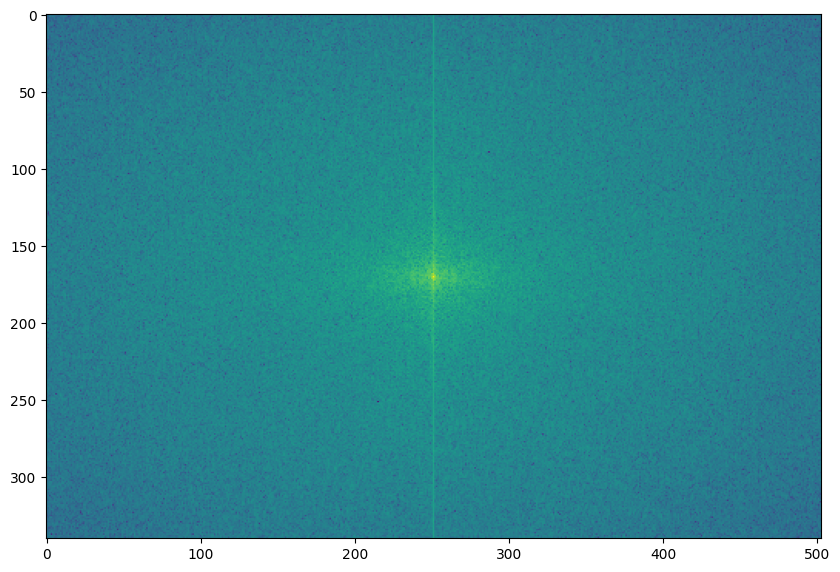

(<Figure size 1000x1000 with 1 Axes>,
 None)

In [ ]:
# The quadrants are needed to be shifted around in order that the low
# spatial frequencies are in the center of the 2D fourier-transformed image.
freq2 = fp.fftshift(freq)
pylab.figure(figsize=(10,10)), pylab.imshow( (20*np.log10( 0.1 +
freq2)).astype(int)), pylab.show()

### The FFT with the numpy.fft module
- DFT của một ảnh có thể được tính với các set hàm tương tự của numpy.fft 

#### Tính toán độ lớn (magnitude) và pha (phase) của một DFT:
Chúng ta sẽ dùng ảnh house.png làm đầu vào vào dùng fft2() để lấy các components thật và giả tưởng của các hệ số Fourier; sau đó tính magnitude/spectrum và pha và cuối cùng sử dụng ifft2() để tái tạo bức ảnh:

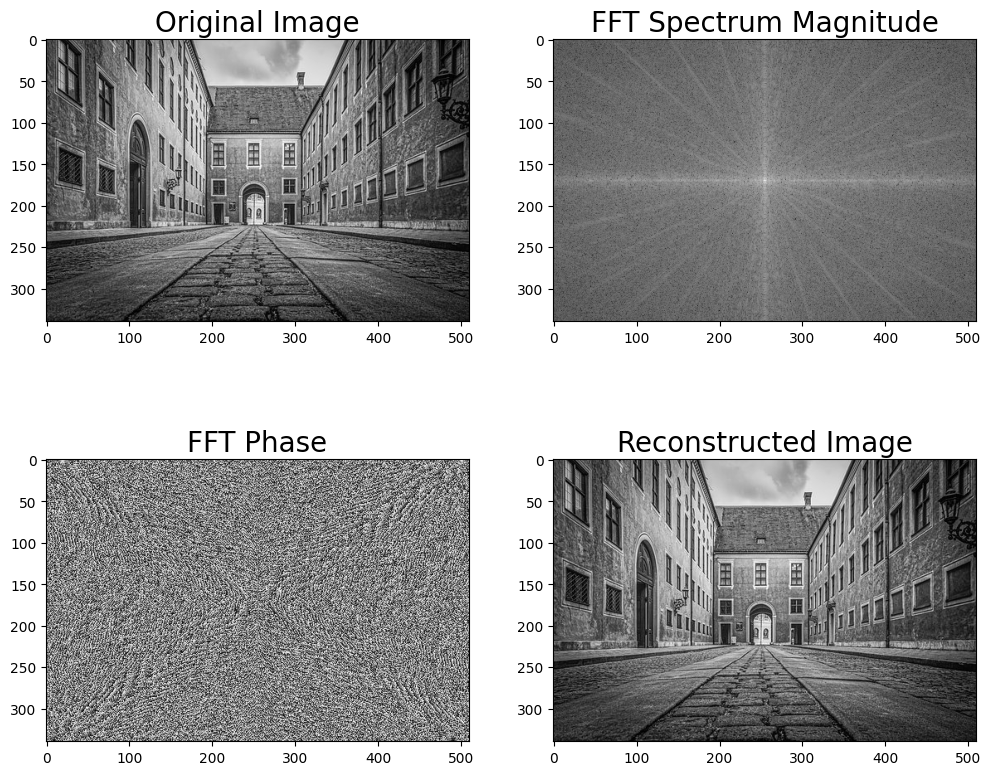

In [ ]:
# ----------------------------------------------------------------------------
'''
GIẢI THÍCH ĐOẠN CODE DƯỚI:
- freq1 = fp.fft2(im1): Thực hiện phép biến đổi Fourier nhanh (FFT) 2D trên ảnh
im1. Kết quả freq1 là một mảng phức chứa các tần số của ảnh.
- im1_ = fp.ifft2(freq1).real: Thực hiện phép biến đổi Fourier ngược (IFFT) để 
tái tạo ảnh từ freq1. .real lấy phần thực của kết quả, tạo thành ảnh tái tạo im1_
- Cuối cùng thực hiện in ra kết quả
'''

from skimage import io, color
import numpy.fft as fp

im1 = io.imread('../../image/house.png', as_gray=True)
pylab.figure(figsize=(12,10))

freq1 = fp.fft2(im1)
im1_ = fp.ifft2(freq1).real

pylab.subplot(2,2,1), pylab.imshow(im1, cmap='gray'), pylab.title('Original Image', size=20)
pylab.subplot(2,2,2), pylab.imshow(20*np.log10( 0.01 +
np.abs(fp.fftshift(freq1))), cmap='gray')
pylab.title('FFT Spectrum Magnitude', size=20)
pylab.subplot(2,2,3), pylab.imshow(np.angle(fp.fftshift(freq1)),cmap='gray')
pylab.title('FFT Phase', size=20)
pylab.subplot(2,2,4), pylab.imshow(np.clip(im1_,0,255), cmap='gray')
pylab.title('Reconstructed Image', size=20)
pylab.show()



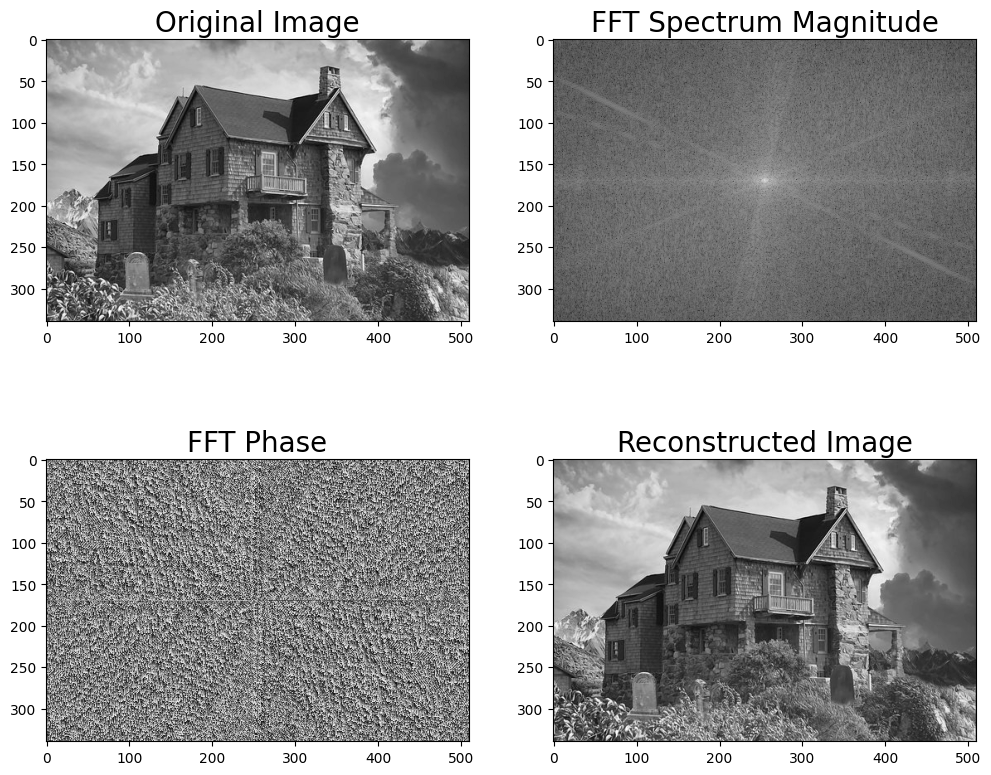

In [ ]:
# Giờ ta sẽ tính spectrum/magnitude, pha, và ảnh được phục dựng với
# một bức ảnh đầu vào khác, house2.png:
# ----------------------------------------------------------------------
'''
GIẢI THÍCH ĐOẠN CODE DƯỚI:
- Đọc ảnh house2.png và chuyển nó thành ảnh mức xám, kết quả lưu vào im2.
- freq2 = fp.fft2(im2): Thực hiện biến đổi Fourier nhanh (FFT) 2D trên ảnh im2, 
lưu trữ trong freq2, là một mảng phức đại diện cho tần số của ảnh
- im2_ = fp.ifft2(freq2).real: Thực hiện biến đổi Fourier ngược (IFFT) để tái tạo 
lại ảnh từ freq2, lưu kết quả trong im2_. .real giữ lại phần thực của kết quả 
để tạo thành ảnh
- Cuối cùng hiển thị kết quả
'''

im2 = io.imread('../../image/house2.png', as_gray=True)
pylab.figure(figsize=(12,10))

freq2 = fp.fft2(im2)
im2_ = fp.ifft2(freq2).real

pylab.subplot(2,2,1), pylab.imshow(im2, cmap='gray'), pylab.title('Original Image', size=20)
pylab.subplot(2,2,2), pylab.imshow(20*np.log10( 0.01 +
np.abs(fp.fftshift(freq2))), cmap='gray')

pylab.title('FFT Spectrum Magnitude', size=20)
pylab.subplot(2,2,3), pylab.imshow(np.angle(fp.fftshift(freq2)),
cmap='gray')

pylab.title('FFT Phase', size=20)
pylab.subplot(2,2,4), pylab.imshow(np.clip(im2_,0,255), cmap='gray')
pylab.title('Reconstructed Image', size=20)
pylab.show()

Mặc dù nó không tường minh như magnitude, pha DFT cũng là thông tin quan trọng và một ảnh không thể được phục dựng tử tế nếu pha ko có hoặc ta sử dụng mảng pha khác

Để thấy được, xem cách một ảnh phục dựng bị distorted nếu dùng component thật của frequency spectrum từ một ảnh và imaginary component từ ảnh khác

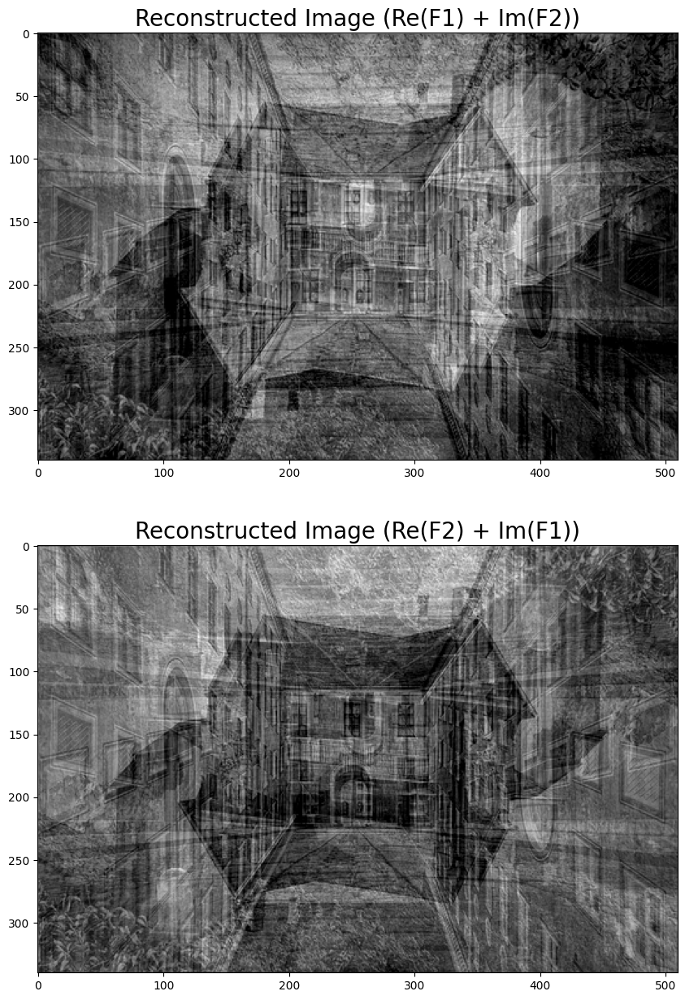

In [ ]:
# ---------------------------------------------------------------------------
'''
- np.vectorize(complex)(freq1.real, freq2.imag): Tạo ra một mảng phức mới từ phần 
thực của freq1 và phần ảo của freq2
- Áp dụng biến đổi Fourier ngược 2D để chuyển mảng phức trở lại miền không gian 
và tái tạo ảnh
'''
pylab.figure(figsize=(20,15))
im1_ = fp.ifft2(np.vectorize(complex)(freq1.real, freq2.imag)).real
im2_ = fp.ifft2(np.vectorize(complex)(freq2.real, freq1.imag)).real
pylab.subplot(211), pylab.imshow(np.clip(im1_,0,255), cmap='gray')
pylab.title('Reconstructed Image (Re(F1) + Im(F2))', size=20)
pylab.subplot(212), pylab.imshow(np.clip(im2_,0,255), cmap='gray')
pylab.title('Reconstructed Image (Re(F2) + Im(F1))', size=20)
pylab.show()

# HIỂU VỀ TÍCH CHẬP (CONVOLUTION)
- Tích chập là một phép toán thực hiện trên hai ảnh, một là ảnh đầu vào và cái còn lại là mặt nạ (còn gọi là kernel) làm bộ lọc trên ảnh đầu vào, tạo ra hình ảnh đầu ra.
- Lọc tích chập (Convolution filtering) được sử dụng để sửa đổi các đặc điểm tần số không gian của một hình ảnh. Nó hoạt động bằng cách xác định giá trị của một điểm ảnh trung tâm bằng cách cộng các giá trị có trọng số của tất cả các điểm ảnh lân cận của nó lại với nhau để tính toán giá trị mới của điểm ảnh trong hình ảnh đầu ra. Các giá trị điểm ảnh trong hình ảnh đầu ra được tính toán bằng cách đi qua cửa sổ kernel thông qua hình ảnh đầu vào

## TẠI SAO CẦN CONVOLVE ẢNH?
- Convolution áp dụng hiệu ứng bộ lọc mục đích chung (general-purpose filter effect ) trên hình ảnh đầu vào. Điều này được thực hiện để đạt được nhiều hiệu ứng khác nhau với các hạt nhân thích hợp trên hình ảnh, chẳng hạn như làm mịn, làm sắc nét và dập nổi, và trong các hoạt động như phát hiện cạnh (edge detection).



0.9921568627450982
(256, 256)


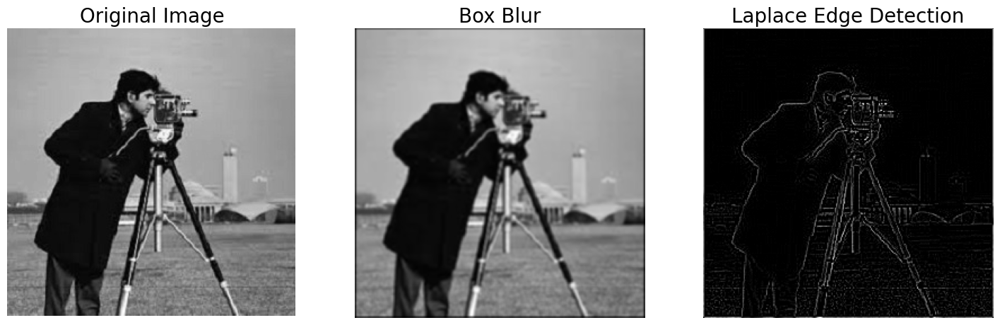

In [ ]:
# Phát hiện edges từ cameraman.jpg sử dụng convolution với Laplace kernel và
# đồng thời làm mờ ảnh sử dụng box kernel:
#------------------------------------------------------------------
'''
GIẢI THÍCH CHO ĐOẠN CODE BÊN DƯỚI:
- Ảnh được đọc từ file cameraman.jpg và chuyển sang ảnh grayscale bằng hàm 
rgb2gray. Sau đó, ảnh được chuyển sang kiểu float để dễ dàng thao tác với các 
giá trị từ 0 đến 1 trong các phép toán sau

- blur_box_kernel: Đây là một bộ lọc làm mờ đơn giản, tính trung bình của các 
điểm ảnh lân cận trong cửa sổ 3x3. Mỗi phần tử trong bộ lọc có giá trị 1/9.
- edge_laplace_kernel: Đây là một bộ lọc phát hiện biên (edge detection) Laplace. 
Các giá trị trọng số trong kernel giúp xác định các điểm ảnh có sự thay đổi mạnh 
về cường độ, để phát hiện các đường biên

- im_blurred: Kết quả của phép tích chập convolve2d giữa ảnh im và 
blur_box_kernel, tạo ra một phiên bản làm mờ của ảnh.
- im_edges: Ảnh sau khi áp dụng bộ lọc phát hiện biên với edge_laplace_kernel. 
Sử dụng np.clip để giới hạn giá trị kết quả trong khoảng [0, 1], giúp hiển thị 
ảnh dễ dàng hơn

- Ba ảnh được hiển thị cạnh nhau trong một sơ đồ gồm ba cột (ncols=3)
+ Original Image: Ảnh gốc ban đầu
+ Box Blur: Ảnh sau khi áp dụng bộ lọc làm mờ.
+ Laplace Edge Detection: Ảnh sau khi phát hiện các cạnh biên bằng bộ lọc Laplace
'''
im = rgb2gray(imread('../../image/cameraman.jpg')).astype(float)
print(np.max(im))
# 1.0
print(im.shape)
# (256, 256)
blur_box_kernel = np.ones((3,3)) / 9
edge_laplace_kernel = np.array([[0,1,0],[1,-4,1],[0,1,0]])
im_blurred = signal.convolve2d(im, blur_box_kernel)
im_edges = np.clip(signal.convolve2d(im, edge_laplace_kernel), 0, 1)
fig, axes = pylab.subplots(ncols=3, sharex=True, sharey=True, figsize=(18, 6))
axes[0].imshow(im, cmap=pylab.cm.gray)
axes[0].set_title('Original Image', size=20)
axes[1].imshow(im_blurred, cmap=pylab.cm.gray)
axes[1].set_title('Box Blur', size=20)
axes[2].imshow(im_edges, cmap=pylab.cm.gray)
axes[2].set_title('Laplace Edge Detection', size=20)
for ax in axes:
  ax.axis('off') # giúp loại bỏ trục tọa độ để hiển thị ảnh rõ ràng hơn.
pylab.show()

### CHẾ ĐỘ CONVOLUTION (CONVOLUTION MODES), CÁC GIÁ TRỊ ĐỆM (PAD VALUES) VÀ CÁC ĐIỀU KIỆN BIÊN (BOUNDARY CONDITIONS)

Phụ thuộc vào bạn muốn làm gì với các góc cạnh pixel, có 3 tham số: mode, boundary, và fillvalue có thể được truyền vào hàm convolve2d(). Tham số mode có thể được giải thích:
- mode = 'full': chế độ mặc định, đầu ra là phép tích chập tuyến tính rời rạc đầy đủ của đầu vào
- mode = 'valid': bỏ qua pixel cạnh và chỉ tính toán cho các pixel có tất cả các lân cận (các pixel không cần đệm số không). Kích thước hình ảnh đầu ra nhỏ hơn kích thước hình ảnh đầu vào cho tất cả các kernel (trừ 1 x 1)
- mode = 'same': ảnh đầu ra có kích cỡ như ảnh đầu vào, nó được căn giữa so với đầu ra 'full'

## ÁP DỤNG CONVOLUTION CHO ẢNH MÀU RGB
- Sử dụng ảnh tajmahal.jpg với kernel emboss và kernel phức hợp phát hiện cạnh schar (the schar edge detection complex kernel)

C:\Users\ACER\AppData\Local\Temp\ipykernel_11468\2772810664.py:8: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  im = imageio.imread('../../image/tajmahal.jpg')/255 # scale each pixel value in


1.0
(1018, 1645, 3)


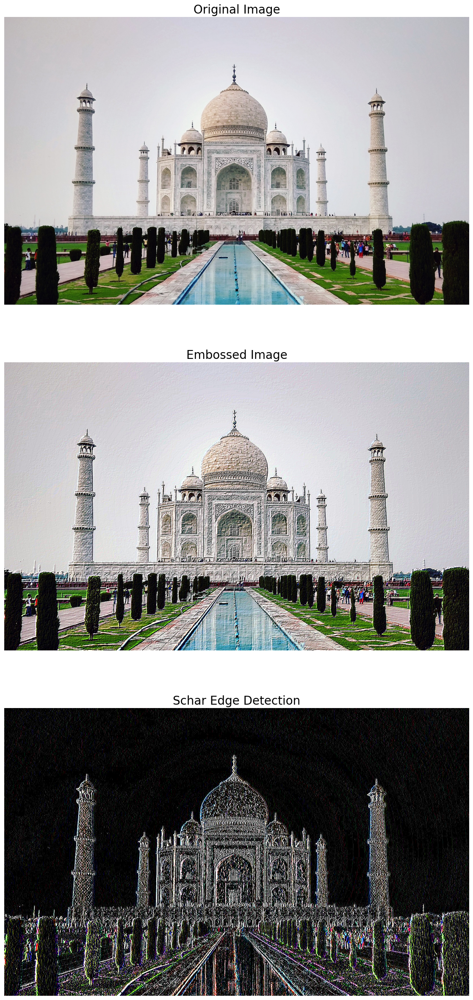

In [ ]:
# ----------------------------------------------------------
'''
GIẢI THÍCH ĐOẠN CODE:
- emboss_kernel: Ma trận 3x3 được thiết kế để tạo hiệu ứng nổi cho ảnh. Bộ lọc 
này sẽ làm nổi các đường viền của ảnh theo hướng nhất định.
- edge_schar_kernel: Bộ lọc phức hợp Scharr 3x3 để phát hiện biên. Nó chứa các 
giá trị phức với cả phần thực và phần ảo, cho phép phát hiện cạnh với các độ 
nghiêng khác nhau trong ảnh.
- im_embossed và im_edges khởi tạo với np.ones(im.shape)
- Vòng lặp for áp dụng phép tích chập convolve2d trên từng kênh màu của ảnh 
(R, G, B) với emboss_kernel:
+ mode='same': Đầu ra có cùng kích thước với ảnh đầu vào
+ boundary="symm": Các cạnh ảnh được xử lý bằng cách phản chiếu giá trị ngoài biên
+ np.clip(..., 0, 1): Giới hạn giá trị pixel để giữ trong khoảng [0, 1]
- Vòng lặp for áp dụng phép tích chập convolve2d trên từng kênh màu của ảnh 
(R, G, B) với edge_schar_kernel:
+ np.real(...): Lấy phần thực của kết quả tích chập (do edge_schar_kernel chứa 
các giá trị phức)
- Cuối cùng thực hiện hiển thị ảnh.
'''
# imread bị gỡ ở bản Scip
import imageio
im = imageio.imread('../../image/tajmahal.jpg')/255 # scale each pixel value in
[0,1]
print(np.max(im))
print(im.shape)
emboss_kernel = np.array([[-2,-1,0],[-1,1,1],[0,1,2]])
edge_schar_kernel = np.array([[ -3-3j, 0-10j, +3 -3j], [-10+0j, 0+ 0j,
+10+0j], [ -3+3j, 0+10j, +3 +3j]])
im_embossed = np.ones(im.shape)
im_edges = np.ones(im.shape)
for i in range(3):
  im_embossed[...,i] = np.clip(signal.convolve2d(im[...,i],
  emboss_kernel, mode='same', boundary="symm"),0,1)
for i in range(3):
  im_edges[:,:,i] = np.clip(np.real(signal.convolve2d(im[...,i],
  edge_schar_kernel, mode='same', boundary="symm")),0,1)
fig, axes = pylab.subplots(nrows=3, figsize=(20, 30))
axes[0].imshow(im)
axes[0].set_title('Original Image', size=20)
axes[1].imshow(im_embossed)
axes[1].set_title('Embossed Image', size=20)
axes[2].imshow(im_edges)
axes[2].set_title('Schar Edge Detection', size=20)
for ax in axes:
  ax.axis('off')
pylab.show()

### Convolution với SciPy ndimage.convolve
- Với SciPy ndimage.convolve chúng ta có thể làm sắc nét hình ảnh RGB trực tiếp (chúng ta không phải áp dụng phép tích chập riêng cho từng kênh hình ảnh)
- Code dưới sử dụng victoria_memorial.png với sharpen kernel và emboss kernel


C:\Users\ACER\AppData\Local\Temp\ipykernel_11468\2165606610.py:7: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  im = imageio.imread('../../image/victoria_memorial.png').astype(float) # read as float


255.0


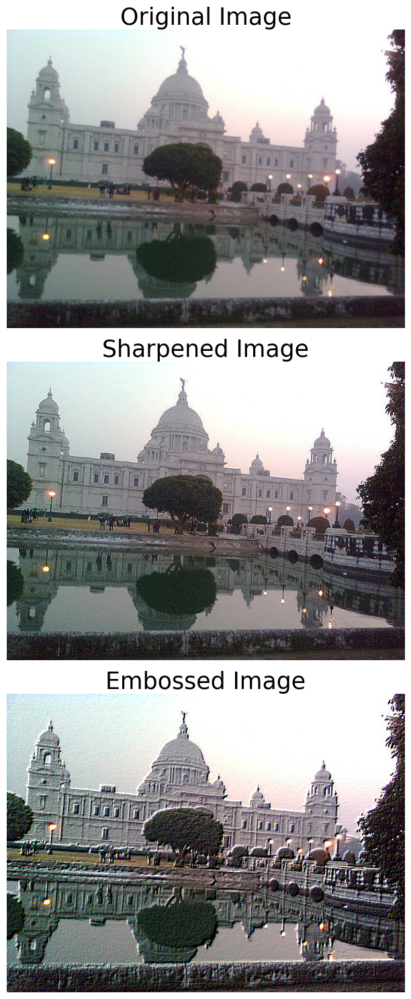

In [ ]:
# ---------------------------------------------------------------------
'''
GIẢI THÍCH ĐOẠN CODE:
- Sau khi chuyển đổi các giá trị pixel sang kiểu float, np.max(im) in ra giá trị
pixel lớn nhất trong ảnh. Do ảnh được đọc dưới dạng float, giá trị này có thể là 
một số lớn hơn 1.0 tùy thuộc vào định dạng ảnh ban đầu
- sharpen_kernel: Ma trận 3x3 có giá trị ở giữa là 5 và các giá trị xung quanh là
-1, giúp làm nổi bật các cạnh bằng cách tăng cường sự khác biệt giữa các pixel 
lân cận
- emboss_kernel: Ma trận 3x3 tạo hiệu ứng nổi, làm nổi các cạnh và tạo chiều 
sâu cho ảnh.
- Cả hai bộ lọc được định hình thành (3, 3, 1), chuẩn bị cho việc áp dụng lên 
ảnh với nhiều kênh màu (RGB)

- ndimage.convolve(im, sharpen_kernel, mode='nearest'): Áp dụng phép tích chập 
(convolution) giữa ảnh và sharpen_kernel:
+ mode='nearest': Các pixel ngoài biên được xử lý bằng cách sao chép giá trị 
pixel gần nhất, tránh tạo hiệu ứng không mong muốn ở rìa ảnh
- np.clip(im_sharp, 0, 255): Giới hạn giá trị pixel trong khoảng [0, 255], đảm 
bảo các giá trị không vượt quá giới hạn của ảnh uint8
- .astype(np.uint8): Chuyển đổi ảnh về kiểu uint8 để sẵn sàng cho việc hiển thị.
'''
im = imageio.imread('../../image/victoria_memorial.png').astype(float) # read as float
print(np.max(im))
sharpen_kernel = np.array([0, -1, 0, -1, 5, -1, 0, -1, 0]).reshape((3, 3, 1))
emboss_kernel = np.array(np.array([[-2,-1,0],[-1,1,1],[0,1,2]])).reshape((3, 3, 1))
im_sharp = ndimage.convolve(im, sharpen_kernel, mode='nearest')
im_sharp = np.clip(im_sharp, 0, 255).astype(np.uint8) # clip (0 to 255) and convert to unsigned int
im_emboss = ndimage.convolve(im, emboss_kernel, mode='nearest')
im_emboss = np.clip(im_emboss, 0, 255).astype(np.uint8)
pylab.figure(figsize=(10,15))
pylab.subplot(311), pylab.imshow(im.astype(np.uint8)), pylab.axis('off')
pylab.title('Original Image', size=25)
pylab.subplot(312), pylab.imshow(im_sharp), pylab.axis('off')
pylab.title('Sharpened Image', size=25)
pylab.subplot(313), pylab.imshow(im_emboss), pylab.axis('off')
pylab.title('Embossed Image', size=25)
pylab.tight_layout()
pylab.show()

## TƯƠNG QUAN SO VỚI TÍCH CHẬP (CORRELATION VS CONVOLUTION)
- Correlation tương tự như phép toán convolution ở chỗ nó cũng lấy một hình ảnh đầu vào và một kernel khác và đi qua cửa sổ kernel thông qua đầu vào bằng cách tính toán sự kết hợp có trọng số của các giá trị lân cận pixel với các giá trị hạt nhân và tạo ra hình ảnh đầu ra.
- Sự khác biệt duy nhất là, không giống như tương quan, phép tích chập lật ngược kernel hai lần (liên quan đến trục ngang và trục dọc) trước khi tính toán tổ hợp có trọng số

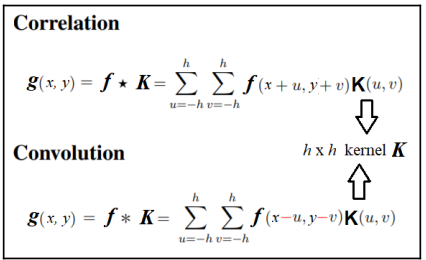
- Hàm correlated2d() có thể được dùng cho phép tương quan. Phép tương quan giống với tích chập nếu kernel đối xứng
- Nếu kernel không đối xứng, để có kết quả như convolution2d(), trước khi đặt kernel lên ảnh, ảnh cần được lật ngược và lật trái sang phải.


C:\Users\ACER\AppData\Local\Temp\ipykernel_20464\3108092354.py:7: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  lena_image = imageio.imread('../../image/lena_g.png').mean(axis=2).astype(float)  # Ensure image is in grayscale and as float for precision


Image shape: (252, 281)


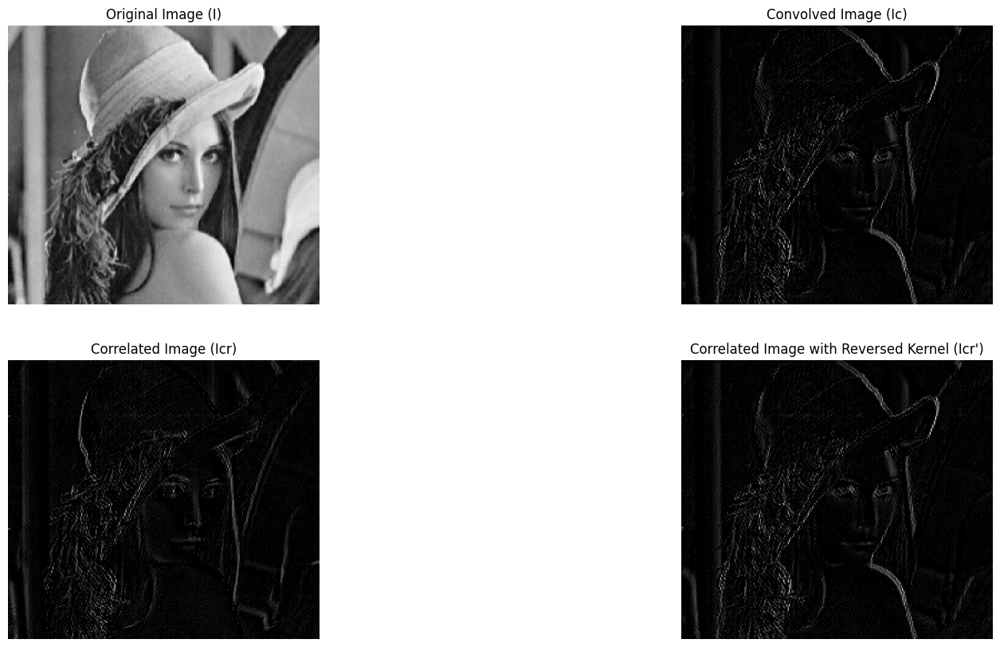

In [7]:
import numpy as np
from scipy import signal, misc
import matplotlib.pyplot as plt
import imageio

# Load and preprocess image
lena_image = imageio.imread('../../image/lena_g.png').mean(axis=2).astype(float)  # Ensure image is in grayscale and as float for precision
print("Image shape:", lena_image.shape)

# Define the asymmetric ripple kernel
ripple_kernel = np.array([[0, -1, np.sqrt(2)],
                          [1, 0, -1],
                          [-np.sqrt(2), 1, 0]])

# Perform correlation
correlated_image = signal.correlate2d(lena_image, ripple_kernel, mode='same', boundary='symm')
correlated_image = np.clip(correlated_image, 0, 255)

# Perform convolution
convolved_image = signal.convolve2d(lena_image, ripple_kernel, mode='same', boundary='symm')
convolved_image = np.clip(convolved_image, 0, 255)

# Apply correlation with reversed kernel (equivalent to convolution with the kernel flipped)
reversed_kernel = np.flip(ripple_kernel)
correlated_reversed_image = signal.correlate2d(lena_image, reversed_kernel, boundary='symm', mode='same')
correlated_reversed_image = np.clip(correlated_reversed_image, 0, 255)

plt.figure(figsize=(20, 10))

plt.subplot(2, 2, 1)
plt.imshow(lena_image, cmap='gray')
plt.title("Original Image (I)")
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(convolved_image, cmap='gray')
plt.title("Convolved Image (Ic)")
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(correlated_image, cmap='gray')
plt.title("Correlated Image (Icr)")
plt.axis('off')

plt.subplot(2, 2, 4)
plt.imshow(correlated_reversed_image, cmap='gray')
plt.title("Correlated Image with Reversed Kernel (Icr')")
plt.axis('off')

plt.show()


### Template matching with cross-correlation between the image and template
- Trong ví dụ này, chúng ta sẽ sử dụng tương quan chéo với hình ảnh mẫu mắt (sử dụng kernel với hình ảnh để tương quan chéo) và vị trí của mắt trong hình ảnh mặt gấu trúc có thể được tìm thấy như sau:

C:\Users\ACER\AppData\Local\Temp\ipykernel_11468\3339688409.py:1: DeprecationWarning: scipy.misc.face has been deprecated in SciPy v1.10.0; and will be completely removed in SciPy v1.12.0. Dataset methods have moved into the scipy.datasets module. Use scipy.datasets.face instead.
  face_image = misc.face(gray=True) - misc.face(gray=True).mean()
C:\Users\ACER\AppData\Local\Temp\ipykernel_11468\3339688409.py:20: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


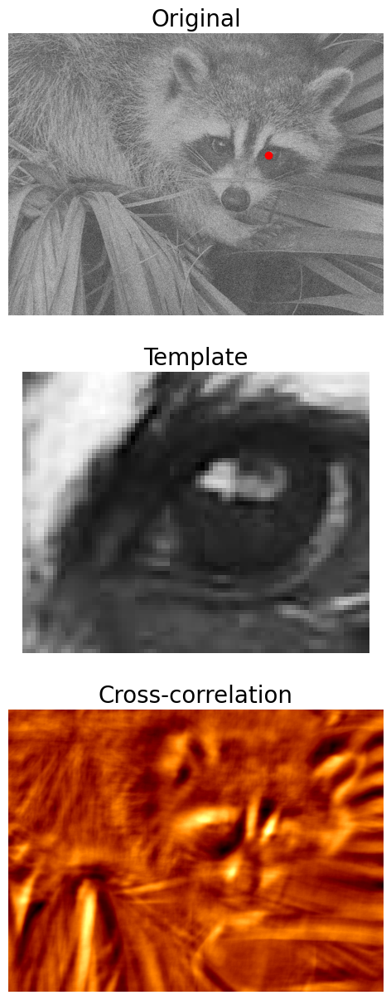

In [ ]:
'''
GIẢI THÍCH ĐOẠN CODE DƯỚI:
- Dòng 1: sau khi chuyển đổi sang ảnh xám, thực hiện trừ giá trị trung bình của
toàn bộ ảnh để trung bình pixel của ảnh bằng 0, giúp tăng cường độ tương phản
của ảnh

- np.copy(face_image[300:365, 670:750]): Tạo một mẫu từ ảnh khuôn mặt, cụ thể là 
phần chứa mắt phải (được xác định bởi tọa độ)
- template_image -= template_image.mean(): Trừ giá trị trung bình của mẫu để 
trung bình pixel của nó cũng bằng 0, giúp tìm kiếm tương quan tốt hơn.

- np.random.randn(*face_image.shape): Tạo một ma trận nhiễu ngẫu nhiên với cùng 
kích thước như ảnh khuôn mặt
- Cộng nhiễu vào face_image, tạo ra một ảnh khuôn mặt có nhiễu, giúp kiểm tra khả 
năng tìm kiếm mẫu trong điều kiện không hoàn hảo

- signal.correlate2d(face_image, template_image, ...): Tính toán phép tương quan 
2 chiều giữa ảnh khuôn mặt có nhiễu và mẫu (mắt phải)
+ boundary='symm': Xử lý biên ảnh theo cách đối xứng, giúp giảm thiểu ảnh hưởng 
của biên trong phép tính tương quan
+ mode='same': Kết quả có cùng kích thước với face_image, cho phép xác định chính 
xác vị trí của mẫu.

- np.argmax(correlation): Tìm chỉ số của giá trị lớn nhất trong ma trận tương 
quan, đại diện cho vị trí mà mẫu khớp tốt nhất với ảnh.
- np.unravel_index(..., correlation.shape): Chuyển đổi chỉ số một chiều thành 
tọa độ hai chiều (y, x) trong ma trận tương quan

- Cuối cùng, tạo một biểu đồ với ba trục con (subplot), mỗi trục sẽ hiển thị 
một phần của quá trình: ảnh gốc, mẫu, và ma trận tương quan
'''

face_image = misc.face(gray=True) - misc.face(gray=True).mean()
template_image = np.copy(face_image[300:365, 670:750]) # right eye
template_image -= template_image.mean()
face_image = face_image + np.random.randn(*face_image.shape) * 50 # add random noise
correlation = signal.correlate2d(face_image, template_image,
boundary='symm', mode='same')
y, x = np.unravel_index(np.argmax(correlation), correlation.shape) # find the match
fig, (ax_original, ax_template, ax_correlation) = pylab.subplots(3, 1,
figsize=(6, 15))
ax_original.imshow(face_image, cmap='gray')
ax_original.set_title('Original', size=20)
ax_original.set_axis_off()
ax_template.imshow(template_image, cmap='gray')
ax_template.set_title('Template', size=20)
ax_template.set_axis_off()
ax_correlation.imshow(correlation, cmap='afmhot')
ax_correlation.set_title('Cross-correlation', size=20)
ax_correlation.set_axis_off()
ax_original.plot(x, y, 'ro')
fig.show()

Có thể thấy rằng một trong các con mắt của gấu trúc trong ảnh đầu vào có độ tương quan chéo cao nhất với hình ảnh mẫu mắt

# KẾT LUẬN
Chúng ta đã thảo luận một số khái niệm quan trọng chủ yếu liên quan đến DFT 2D và các ứng dụng liên quan trong xử lý hình ảnh, chẳng hạn như lọc trong miền tần số và chúng tôi đã làm việc trên khá nhiều ví dụ bằng cách sử dụng các mô-đun scikit-image numpy.fft, scipy.fftpack, signal và ndimage.